# Chapter 3.1: Estimated Infections vs Confirmed Cases

In [1]:
import pandas as pd
import requests
import plotly.express as px
from urllib.request import urlopen
import json
import datetime
from datetime import timedelta

In [2]:
response = requests.get('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_US.csv')
response2 = requests.get('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_US.csv')

In [3]:
if response.status_code != 200 or response2.status_code != 200:
    print('ERROR')
# Checking that the download was successful

In [4]:
pop_df = pd.read_csv('census.csv', dtype = {'FIPS': 'string'} )

In [5]:
def zero_fill(x):
    x = x[:-2]
    if len(x) < 5:
        return '0' + x
    return x

In [6]:
deaths_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/'+
            'master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_US.csv', dtype = {'FIPS': 'string'})
# reading the csv file from github that contains the deaths by county from 1/22/20 - the current day
deaths_df = deaths_df[deaths_df['iso3'] == 'USA'] 
deaths_df = deaths_df.reset_index()
deaths_df = deaths_df.drop('index', axis=1)
deaths_df = deaths_df.fillna('0') 
deaths_df = deaths_df.drop(['UID', 'Lat', 'Long_', 'iso2', 'iso3', 'code3', 'Combined_Key',  'Province_State', 'Country_Region', 'Population'], axis=1)
deaths_df['FIPS'] = deaths_df['FIPS'].apply(zero_fill)
deaths_df = pd.merge(pop_df, deaths_df, on='FIPS')
deaths_df.to_csv('US_Deaths.csv', index = False)

In [7]:
confirmed_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_US.csv', dtype = {'FIPS': 'string'})
# reading the csv file from github that contains the cases by county from 1/22/20 - the current day
confirmed_df = confirmed_df[confirmed_df['iso3'] == 'USA'] 
confirmed_df = confirmed_df.reset_index()
confirmed_df = confirmed_df.drop('index', axis=1)
confirmed_df = confirmed_df.fillna('0')
confirmed_df = confirmed_df.drop(['UID', 'Lat', 'Long_', 'iso2', 'iso3', 'code3', 'Combined_Key', 'Province_State', 'Country_Region'], axis=1)
confirmed_df['FIPS'] = confirmed_df['FIPS'].apply(zero_fill)
confirmed_df = pd.merge(pop_df, confirmed_df, on='FIPS')
confirmed_df.to_csv('US_Confirmed.csv', index = False)

In [8]:
confirmed_df['cases/pop'] = confirmed_df.iloc[:,-18] / confirmed_df['Population'] * 1000

In [9]:
deaths_df['Infection_Estimates'] = (deaths_df.iloc[:,-1] * 100) / deaths_df['Population'] * 1000

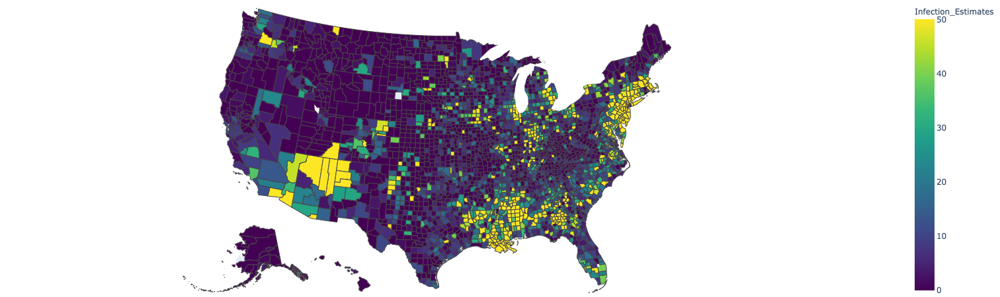

In [10]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
fig = px.choropleth(deaths_df, geojson=counties, scope="usa", locations='FIPS', color= 'Infection_Estimates',
                        color_continuous_scale="Viridis",
                        range_color=(0, 50))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

This is the estimated infection rate in the US if a death rate of 1% is applied to the reported death count. Due to the average 18 day delay between infection and death, this graph displays case estimates 18 days prior to the current date. Each county's estimated case count has been standardized by it's 2019 census population as well.

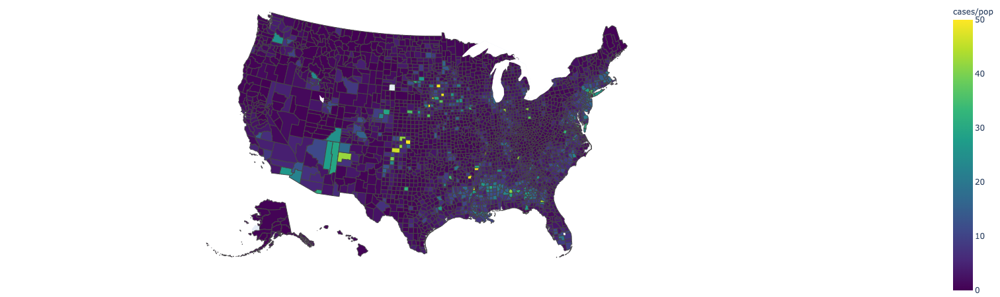

In [11]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
fig = px.choropleth(confirmed_df, geojson=counties, scope="usa", locations='FIPS', color= 'cases/pop',
                        color_continuous_scale="Viridis",
                        range_color=(0, 50))
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

This is the number of reported cases by county and standardized by population. As the infection estimate in Figure 1 can only estimate case counts 18 days out, this is a representation of case counts 18 days ago. 